# Pandas 

### Time series processing & visualization

<!-- ## Marco Forgione -->



### Introduction

* We can deal with **time series** data with the general methods already introduced in the course.

* We can sometimes do more with less effort using **specific tools** available in pandas.

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px

In [2]:
# Change some default matplotlib settings
plt.style.use('seaborn-whitegrid')
plt.rcParams['figure.figsize'] = [25, 10]
plt.rcParams['font.size'] = 20

In [3]:
class display(object):
    """Display HTML representation of multiple objects"""
    template = """<div style="float: left; padding: 10px;">
    <p style='font-family:"Courier New", Courier, monospace'>{0}</p>{1}
    </div>"""
    def __init__(self, *args):
        self.args = args
        
    def _repr_html_(self):
        return '\n'.join(self.template.format(a, eval(a)._repr_html_())
                         for a in self.args)
    
    def __repr__(self):
        return '\n\n'.join(a + '\n' + repr(eval(a)) for a in self.args)

### Climate in Lugano, 1864-today

Monthly average temperature ($^o\rm C$) and total precipitations (mm) in Lugano, from [MeteoSwiss](https://www.meteoswiss.admin.ch/home.html?tab=overview)

In [4]:
# https://www.meteoswiss.admin.ch/product/output/climate-data/homogenous-monthly-data-processing/data/homog_mo_LUG.txt
df_temp = pd.read_csv(os.path.join("data", "climate_lugano.csv"), delim_whitespace=True)
df_temp.head(24) # the first two years

,Year,Month,Temperature,Precipitation
0,1864,1,-1.6,7.5
1,1864,2,1.8,92.7
2,1864,3,7.2,80.4
3,1864,4,10.9,12.8
4,1864,5,15.0,134.0
5,1864,6,18.2,169.2
6,1864,7,21.0,49.6
7,1864,8,19.5,179.3
8,1864,9,16.4,242.1
9,1864,10,10.4,307.9


### Climate in Lugano, 1864-today

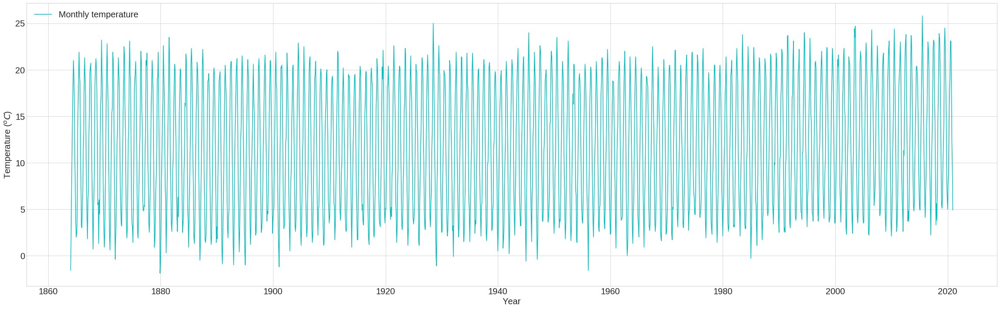

In [5]:
plt.figure(figsize=(40, 12))
#plt.plot(data["Year"], data["Temperature"], 'c', label="Monthly")
year_month = df_temp["Year"] + (df_temp["Month"]-1)/12 # not exact, but good enough
plt.plot(year_month, df_temp["Temperature"], 'c', label="Monthly temperature")
plt.legend(loc="upper left");
plt.xlabel("Year")
plt.ylabel("Temperature ($^oC$)");
#plt.xlim([2018, 2020]); # uncomment to see the yearly pattern more clearly!

* There is a strong **yearly pattern** related to the seasons: winter is colder than summer!
* There seems to be an **increasing trend** starting from the '80s. 

Note the small hack used to define the time variable for the plot:

In [6]:
 year_month = df_temp["Year"] + (df_temp["Month"]-1)/12

### Yearly average using groupby

We can get rid of the *seasonality* by averaging over periods of one year. A pandas groupby comes in handy:

In [7]:
df_temp_year = df_temp.groupby("Year", as_index=False)[["Temperature", "Precipitation"]].mean() # Temperature averaged by year
display('df_temp', 'df_temp_year')

,Year,Month,Temperature,Precipitation
0,1864,1,-1.6,7.5
1,1864,2,1.8,92.7
2,1864,3,7.2,80.4
3,1864,4,10.9,12.8
4,1864,5,15.0,134.0
...,...,...,...,...
1879,2020,8,23.1,200.3
1880,2020,9,18.9,125.0
1881,2020,10,12.3,287.8
1882,2020,11,9.5,2.8


The operation above is equivalent to a **yearly resampling** of the dataset.

### Yearly average using groupby

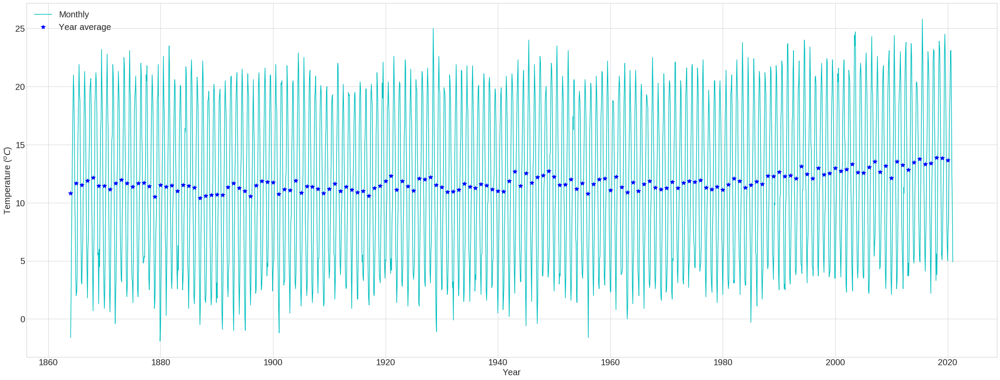

In [8]:
plt.figure(figsize=(40, 15))
year_month = df_temp["Year"] + (df_temp["Month"]-1)/12 # not exact, but good enough
plt.plot(year_month, df_temp["Temperature"], 'c', label="Monthly")
plt.plot(df_temp_year["Year"], df_temp_year["Temperature"], 'b*',  markersize=10, label="Year average")
plt.xlabel("Year")
plt.ylabel("Temperature ($^oC$)")
plt.legend();

The increasing trend is now *more evident* in the **Year average** signal as the yearly variation has been removed.

### Monthly average using groupy

What if we group according to the **Month** instead of the **Year**? We get the 12 monthly averages.

In [9]:
df_temp_month_avg = df_temp.groupby("Month")[["Temperature"]].mean() # .median()

In [10]:
df_temp_month_avg # Mean temperature of the different months

,Temperature
Month,
1,2.475159
2,3.856688
3,7.378344
4,11.157962
5,15.140764
6,18.949682
7,21.340764
8,20.515924
9,17.169427


The average is performed over the years in the dataset.

### Monthly average using groupy

Makes sense to represent these monthly averages with a **bar plot**

In [11]:
fig = px.bar(df_temp_month_avg, x=df_temp_month_avg.index, y="Temperature", width=2200, height=600)
fig.update_layout(
    xaxis=dict(
        tickmode = 'array',
        tickvals = df_temp_month_avg.index,
        ticktext = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]
    ),     font_size=20
); fig.show()

We lose all information about the trend and focus on the **yearly pattern**.

Note that it is not a signal over time: it combines data from all years!

### Grouped monthly box plot

Box plots for the temperature for the 12 months

In [12]:
fig = px.box(df_temp, x="Month", y="Temperature", width=2200, height=600)

fig.update_layout(
    xaxis=dict(
        tickmode = 'array',
        tickvals = np.arange(1,13),
        ticktext = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]
    ),
    font_size=20
)

The focus is on the yearly trend, as in the previous plot. We include information about **variability** within the months.

### Pandas time series tools

So far, we have used standard pandas processing operations (groupby).

There exist specialized tools to process time series data. Common operations:
 * access
 * resample
 * filter 

To use these specialized tools, the first step is to transform the time stamp to a specific pandas datetime format.

### Dates in pandas

When we import data from external sources (ex: csv files), dates are often read as strings.

In [13]:
df = pd.DataFrame({"timestamp": ["21/05/2021 14:00", "28/05/2021 14:00", "04/06/2021 15:30"], "val": np.random.randn(3)})
df

,timestamp,val
0,21/05/2021 14:00,0.491284
1,28/05/2021 14:00,0.849963
2,04/06/2021 15:30,-1.890361


In [14]:
type(df["timestamp"].iloc[0])

str

Pandas provides the function ``pd.to_datetime`` which converts different representations to a specific datetime format

In [15]:
df["timestamp"] = pd.to_datetime(df["timestamp"], dayfirst=True)  # specify that the first field is the day
#df["timestamp"] = pd.to_datetime(df["timestamp"],format='%d/%m%/Y')  # specity a format
df["timestamp"]

0   2021-05-21 14:00:00
1   2021-05-28 14:00:00
2   2021-06-04 15:30:00
Name: timestamp, dtype: datetime64[ns]

Converting dates to this format has advantages. The ``dt`` attribute of a datetime Series contains several useful fields

In [16]:
df["timestamp"].dt.year # .month, .day, .weekday, .hour, .minute, .second ...

0    2021
1    2021
2    2021
Name: timestamp, dtype: int64

### Dataframes with DatetimeIndex

For time series data, it is often useful to set the date *as index* of the dataframe.

In [17]:
df_temp_dt = df_temp.copy()
df_temp_dt["Day"] = 1; df_temp_dt["Date"] = pd.to_datetime(df_temp_dt[["Year", "Month", "Day"]]) # create a column data using pd.to_datetime
df_temp_dt.set_index("Date", inplace=True); df_temp_dt = df_temp_dt[["Temperature", "Precipitation"]]
df_temp_dt.head(6)

,Temperature,Precipitation
Date,,
1864-01-01,-1.6,7.5
1864-02-01,1.8,92.7
1864-03-01,7.2,80.4
1864-04-01,10.9,12.8
1864-05-01,15.0,134.0
1864-06-01,18.2,169.2


In [18]:
df_temp_dt.index

DatetimeIndex(['1864-01-01', '1864-02-01', '1864-03-01', '1864-04-01',
               '1864-05-01', '1864-06-01', '1864-07-01', '1864-08-01',
               '1864-09-01', '1864-10-01',
               ...
               '2020-03-01', '2020-04-01', '2020-05-01', '2020-06-01',
               '2020-07-01', '2020-08-01', '2020-09-01', '2020-10-01',
               '2020-11-01', '2020-12-01'],
              dtype='datetime64[ns]', name='Date', length=1884, freq=None)

The DatetimeIndex object has the same useful attributes of the datetime Series

In [19]:
df_temp_dt.index.year # .year, .month, .day, .weekday, .hour, .minute, .second ...

Int64Index([1864, 1864, 1864, 1864, 1864, 1864, 1864, 1864, 1864, 1864,
            ...
            2020, 2020, 2020, 2020, 2020, 2020, 2020, 2020, 2020, 2020],
           dtype='int64', name='Date', length=1884)

### Row access using date string

Accessing rows with a **date string** is now possible

In [20]:
df_temp_dt.loc["2001"] # all data of year 2001

,Temperature,Precipitation
Date,,
2001-01-01,3.6,127.9
2001-02-01,6.3,86.5
2001-03-01,9.0,202.8
2001-04-01,11.4,73.7
2001-05-01,17.3,103.6
2001-06-01,19.4,243.5
2001-07-01,21.7,229.8
2001-08-01,22.3,245.5
2001-09-01,15.7,69.0


You may also specity a date range:

In [21]:
df_temp_dt.loc["2001-02":"2001-04"]

,Temperature,Precipitation
Date,,
2001-02-01,6.3,86.5
2001-03-01,9.0,202.8
2001-04-01,11.4,73.7


Pandas is smart enough to infer the date format, most of the times...

In [22]:
df_temp_dt.loc["02/2001":"04/2001"]

,Temperature,Precipitation
Date,,
2001-02-01,6.3,86.5
2001-03-01,9.0,202.8
2001-04-01,11.4,73.7


### Resampling

Resampling refers to changing the time granularity. In pandas, this can be implemented with a one-liner

In [23]:
df_temp_y = df_temp_dt[["Temperature", "Precipitation"]].resample("Y").mean() # resample to one year ("Y"), take the average

In [24]:
df_temp_y.head()

,Temperature,Precipitation
Date,,
1864-12-31,10.808333,118.108333
1865-12-31,11.691667,115.708333
1866-12-31,11.533333,113.333333
1867-12-31,11.908333,132.608333
1868-12-31,12.150000,162.358333


Common aggregations: ``.resample("D")`` = daily, ``.resample("W")`` = weekly, ``.resample("M")`` = monthly.

The resampling mechanism supports the aggregation logic of grouped pandas objects (``groupby``):

In [25]:
df_temp_year_ = df_temp_dt[["Temperature", "Precipitation"]].resample("Y").agg({"Temperature": np.mean, "Precipitation": np.sum}) # resample to one year, mean temperature and total precipitation
df_temp_year_.head()

,Temperature,Precipitation
Date,,
1864-12-31,10.808333,1417.3
1865-12-31,11.691667,1388.5
1866-12-31,11.533333,1360.0
1867-12-31,11.908333,1591.3
1868-12-31,12.150000,1948.3


### Running Average

Running (rolling, moving) average is a very common **filtering operation** for time series data. It is particularly useful for *noisy* data.

<center>
<p align="center">
 <img src="img/y.png" alt="y_noise" width=1000> 
</p>
</center>

For each sample, the running average of a signal over a window of length W is defined as:
* The mean over a window of the W *previous* samples (standard, causal moving average)
* The mean over a window of W samples *centered* around the current sample (centered moving average)

<center>
<p align="center">
 <img src="img/y_MA.png" alt="y_MA" width=1000> 
</p>
</center>


### Running Average in pandas

Running average can be implemented using the ``rolling`` method. It is also very similar to a ``groupby``:

In [26]:
df_temp_ma12 = df_temp_dt[["Temperature", "Precipitation"]].rolling(12, center=False).mean() # apply the mean function over the previous 12 months

In [27]:
display('df_temp_dt.head(14)', 'df_temp_ma12.head(14)')

,Temperature,Precipitation
Date,,
1864-01-01,-1.6,7.5
1864-02-01,1.8,92.7
1864-03-01,7.2,80.4
1864-04-01,10.9,12.8
1864-05-01,15.0,134.0
1864-06-01,18.2,169.2
1864-07-01,21.0,49.6
1864-08-01,19.5,179.3
1864-09-01,16.4,242.1


In [28]:
np.mean(df_temp_dt.iloc[0:12])

Temperature       10.808333
Precipitation    118.108333
dtype: float64

In [29]:
np.mean(df_temp_dt.iloc[1:13])

Temperature       11.108333
Precipitation    120.550000
dtype: float64

### Plot with dates

/home/marco/anaconda3/envs/DL_ID/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning:

Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()



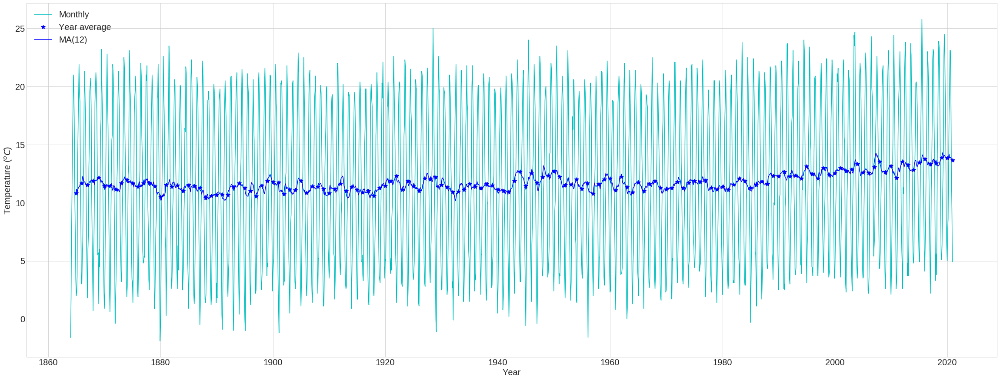

In [30]:
plt.figure(figsize=(40, 15))
plt.plot(df_temp_dt.index, df_temp_dt["Temperature"], 'c', label="Monthly")
plt.plot(df_temp_y.index, df_temp_year["Temperature"], 'b*', markersize=10, label="Year average")
plt.plot(df_temp_ma12.index, df_temp_ma12["Temperature"], 'b-', label="MA(12)")
#plt.grid(True)
plt.xlabel("Year")
plt.ylabel("Temperature ($^oC$)")
plt.legend(loc="upper left");

Matplotlib (and other plotting libraries) can handle pandas dates correctly. No need to sum year and month!

### Monthly Bar Plot

Bar plot of the mean (median) temperature for the 12 months

In [31]:
df_temp_month_avg = df_temp_dt.groupby(df_temp_dt.index.month).mean() # .median()
df_temp_month_avg.index = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]
df_temp_month_avg.index.name = "Month"

In [32]:
fig = px.bar(df_temp_month_avg, y="Temperature", width=2200, height=600)
fig.update_layout(font_size=20, xaxis_title="Month")
fig.show()

Note: we can extract the month from the index to do the groupby. No need to have a Month column in the dataframe.

### Grouped monthly box plot

Box plots of the temperatore for the 12 months

In [33]:
fig = px.box(df_temp_dt, x=df_temp_dt.index.month, y="Temperature", width=2200, height=600)

fig.update_layout(
    xaxis=dict(
        tickmode = 'array',
        tickvals = df_temp_dt.index.month,
        ticktext = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]
    ),
    font_size=20,
    xaxis_title="Month"
)
fig.show()

### Bike traffic over the Fremont Bridge in Seattle

The Lugano temperature time series was rather simple:

 * Yearly pattern
 * Slow trend

Let us consider a more complex example from the [Python Data Science Handbook](https://jakevdp.github.io/PythonDataScienceHandbook/03.11-working-with-time-series.html): the [Seattle Bycicle Count Dataset](https://data.seattle.gov/Transportation/Fremont-Bridge-Bicycle-Counter/65db-xm6k).

In [34]:
df_hour = pd.read_csv(os.path.join("data", "Fremont_Bridge_Bicycle_Counter.csv"), index_col='Date', parse_dates=True)
df_hour.columns = ['Total', 'West', 'East']

In [35]:
df_hour

,Total,West,East
Date,,,
2012-10-03 00:00:00,13.0,4.0,9.0
2012-10-03 01:00:00,10.0,4.0,6.0
2012-10-03 02:00:00,2.0,1.0,1.0
2012-10-03 03:00:00,5.0,2.0,3.0
2012-10-03 04:00:00,7.0,6.0,1.0
...,...,...,...
2020-07-31 19:00:00,191.0,87.0,104.0
2020-07-31 20:00:00,141.0,54.0,87.0
2020-07-31 21:00:00,75.0,29.0,46.0


* Number of bikes travelling through the [Fremont Bridge](https://en.wikipedia.org/wiki/Fremont_Bridge_(Seattle)) in Seattle. 
* Two pathways: West/East
* Measurements at *hourly frequency*, starting from 2012 until now

### Bike traffic over the Fremont Bridge in Seattle

<img src="img/biker.jpeg">

A similar counter is on the other side of the road.

### Hourly bike count
A very rich time series

In [36]:
fig = px.line(df_hour, width=2200, height=600)  #fig = px.line(df_hour, x=df_hour.index, y=["Total", "West", "East"], height=800, width=1200)
fig.update_layout(font_size=20, yaxis_title="Hourly Bicycle Count"); fig.show()

* Yearly pattern: people do not like to bike in winter?
* Increasing trend over the years. People are biking more and more?
* Abrupt change in 2020: COVID19-related?
* A lot of high-frequency variation. Daily? Weekly?

Note:
* We did not specify the x option: it is the index **time** by default
* We did not specify the y option: all the time series  ("Total", "West", "East) have been visualized

We can zoom in and (try to) understand more of this dataset.

### Daily resample

In [37]:
df_day = df_hour.resample('D').sum()

In [38]:
df_day.head()

,Total,West,East
Date,,,
2012-10-03,7042.0,3520.0,3522.0
2012-10-04,6950.0,3416.0,3534.0
2012-10-05,6296.0,3116.0,3180.0
2012-10-06,4012.0,2160.0,1852.0
2012-10-07,4284.0,2382.0,1902.0


In [39]:
fig = px.line(df_day) # or df_day.plot()
fig.update_layout(font_size=20, yaxis_title="Daily Bicycle Count", width=2200, height=600); fig.show()

### Weekly resample

In [40]:
df_week = df_hour.resample('W').sum()

In [41]:
df_week.head()

,Total,West,East
Date,,,
2012-10-07,28584.0,14594.0,13990.0
2012-10-14,33590.0,17358.0,16232.0
2012-10-21,31018.0,15892.0,15126.0
2012-10-28,26874.0,13802.0,13072.0
2012-11-04,24388.0,12816.0,11572.0


In [42]:
fig = px.line(df_week)
fig.update_layout(font_size=20, yaxis_title="Weekly Bicycle Count", width=2200, height=600); fig.show()

### Monthly resample

In [43]:
df_month = df_day.resample('M').sum()

In [44]:
df_month.head()

,Total,West,East
Date,,,
2012-10-31,131390.0,67528.0,63862.0
2012-11-30,101294.0,52124.0,49170.0
2012-12-31,72738.0,37216.0,35522.0
2013-01-31,89768.0,45820.0,43948.0
2013-02-28,100054.0,51796.0,48258.0


In [45]:
fig = px.line(df_month)
fig.update_layout(font_size=20, yaxis_title="Monthly Bicycle Count", width=2200, height=600); fig.show()

### 31-day moving average

In [46]:
df_day_ma31 = df_day.rolling(31, center=True).mean()
df_day_ma31.iloc[14:24]

,Total,West,East
Date,,,
2012-10-17,NaN,NaN,NaN
2012-10-18,4533.161290,2333.548387,2199.612903
2012-10-19,4367.419355,2253.096774,2114.322581
2012-10-20,4208.451613,2178.258065,2030.193548
2012-10-21,4186.645161,2170.000000,2016.645161
2012-10-22,4218.064516,2183.354839,2034.709677
2012-10-23,4255.290323,2197.225806,2058.064516
2012-10-24,4200.709677,2166.645161,2034.064516
2012-10-25,4130.064516,2133.870968,1996.193548


In [47]:
fig = px.line(df_day_ma31)
fig.update_layout(font_size=20, yaxis_title="Bicycle Count MA(30)", width=2200, height=600); fig.show()

Similar to the 1-month resampling, but keeps the daily granularity

### Aggregation by weekday

In [48]:
by_weekday = df_hour.groupby(df_hour.index.dayofweek).mean()
by_weekday.index = ['Mon', 'Tues', 'Wed', 'Thurs', 'Fri', 'Sat', 'Sun']
by_weekday.index.name = 'Day'
by_weekday

,Total,West,East
Day,,,
Mon,132.196176,58.726829,73.469347
Tues,140.684473,62.781750,77.902723
Wed,139.653444,62.349715,77.303729
Thurs,132.893035,59.720253,73.172782
Fri,120.148121,53.910577,66.237544
Sat,63.932357,32.096478,31.835879
Sun,62.128204,31.608578,30.519626


In [49]:
fig = px.bar(by_weekday)
fig.update_layout(font_size=20, yaxis_title="Daily Bicycle Count", xaxis_title="Day", barmode="group", width=2200, height=600); fig.show()

Bike traffic is much reduced during weekends. People bike to work?

### Aggregation by time

In [50]:
by_time = df_hour.groupby(df_hour.index.time).mean()
by_time.index.name = "Hour"

In [51]:
by_time.head()

,Total,West,East
Hour,,,
00:00:00,11.325267,4.804270,6.520996
01:00:00,5.998043,2.687367,3.310676
02:00:00,3.947387,1.894774,2.052613
03:00:00,2.907651,1.495730,1.411922
04:00:00,6.498754,3.446263,3.052491


In [52]:
fig = px.line(by_time)
fig.update_layout(font_size=20, yaxis_title="Hourly Mean Bicycle Count", width=2200, height=600); fig.show()

Bimodal shape with peaks at 8:00 and 18:00. This consolidates the hypothesis that people are biking to work!

### Aggregation by time, weekdays vs. weekends

In [53]:
weekend = np.where(df_hour.index.weekday < 5, 'Weekday', 'Weekend')
by_time_day = df_hour.groupby([weekend, df_hour.index.time]).mean()

In [54]:
by_time_day.head()

Total      West      East
Weekday 00:00:00  9.478337  4.066484  5.411853
        01:00:00  4.695966  2.111305  2.584661
        02:00:00  3.130229  1.542829  1.587400
        03:00:00  2.691235  1.403386  1.287849
        04:00:00  7.558267  4.190737  3.367530

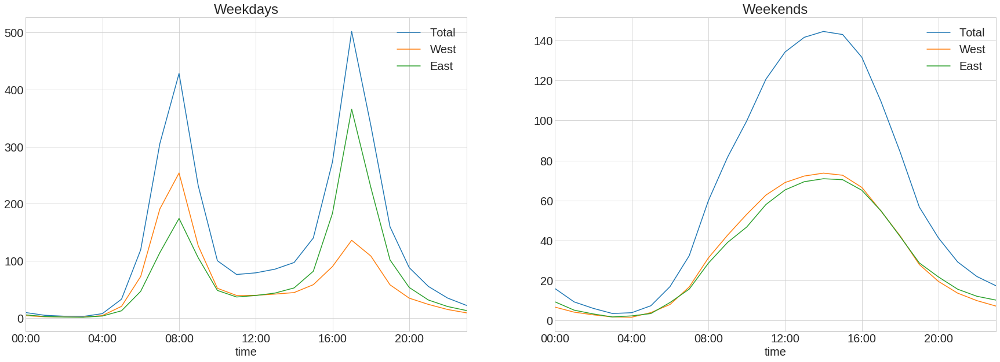

In [55]:
hourly_ticks = 4 * 60 * 60 * np.arange(6)
fig, ax = plt.subplots(1, 2, figsize=(30, 10))
by_time_day.loc['Weekday'].plot(ax=ax[0], title='Weekdays', xticks=hourly_ticks)
by_time_day.loc['Weekend'].plot(ax=ax[1], title='Weekends', xticks=hourly_ticks);

In the weekend, people go for a leisure bike ride instead?

### Stock market

These time series are even more complex.

In [56]:
from pandas_datareader import data as data_reader
tesla_stock = data_reader.DataReader('TSLA', start='2011', end='2021',data_source='yahoo')
tesla_stock.head()

ModuleNotFoundError: No module named 'pandas_datareader'

In [ ]:
tesla_stock = tesla_stock[["Close"]] # Let's restrict to the daily closing
tesla_stock["Close_MA30"] = tesla_stock["Close"].rolling(30, center=True).mean() # Moving average

In [ ]:
fig = px.line(tesla_stock, y=["Close", "Close_MA30"], width=2200, height=600)
fig.show()

If you are able to predict these patterns, you can make a lot of money!